In [11]:
import numpy as np
import matplotlib.pyplot as plt
import torch

In [12]:
x = torch.tensor([0, 1, 2, 3, 4, 5, 6, 7.])
x

tensor([0., 1., 2., 3., 4., 5., 6., 7.])

In [13]:
m = -0.5
b = 2

In [14]:
y = x*m + b + torch.normal(mean = torch.zeros(8), std = 0.2)
y

tensor([ 1.9521,  1.3556,  1.0166,  0.7396, -0.3376, -0.5466, -0.6798, -1.7468])

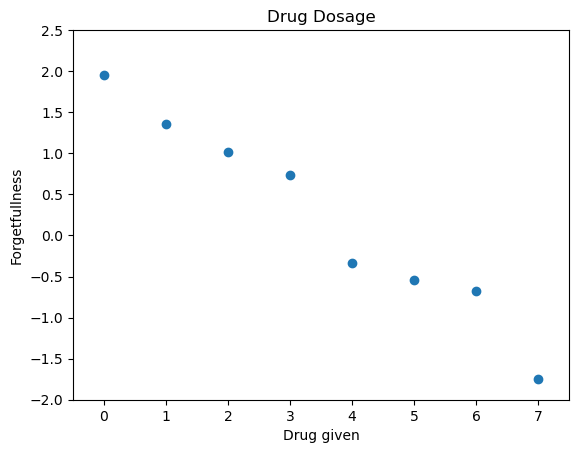

In [15]:
fig, ax = plt.subplots()
plt.title("Drug Dosage")
plt.xlabel("Drug given")
plt.ylabel("Forgetfullness")
ax.set_xlim(-0.5, 7.5)
ax.set_ylim(-2, 2.5)
ax.scatter(x, y)

In [16]:
def regression(x, m, b):
    return m*x + b

In [17]:
def regression_plot(my_x, my_y, my_m, my_b):
    fig, ax = plt.subplots()
    ax.scatter(my_x, my_y)
    x_min, x_max = ax.get_xlim()
    y_min = regression(x_min, my_m, my_b)
    y_max = regression(x_max, my_m, my_b)
    ax.set_xlim([x_min, x_max])
    ax.plot([x_min, x_max], [y_min, y_max])

In [18]:
m = torch.tensor(0.9, requires_grad=True)
b = torch.tensor(0.1, requires_grad=True)

In [19]:
def mse(y_hat, y):
    return torch.sum((y_hat - y)**2)/len(y)

0.8999999761581421     0.10000000149011612
0.5410457849502563     0.03938298672437668
0.31196871399879456     0.005105104297399521
0.16546806693077087     -0.01245182752609253
0.07147163897752762     -0.019402574747800827
0.010860510170459747     -0.019634557887911797
-0.028520483523607254     -0.015619121491909027
-0.05439920723438263     -0.008927326649427414
-0.07168880850076675     -0.0005578575655817986
-0.08351290971040726     0.008854495361447334
-0.0918574407696724     0.018906287848949432
-0.09798500686883926     0.029341164976358414
-0.10269837081432343     0.039996273815631866
-0.10650791227817535     0.05076821148395538
-0.10973814874887466     0.06159138306975365
-0.11259542405605316     0.07242420315742493
-0.11521095782518387     0.08324037492275238
-0.11766818165779114     0.09402331709861755
-0.12002018094062805     0.10476259887218475
-0.12230072915554047     0.11545173823833466
-0.1245313286781311     0.12608672678470612


C:\Users\Rakshit Srivastava\AppData\Local\Temp\ipykernel_16196\4257342232.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


-0.12672565877437592     0.13666516542434692
-0.1288924664258957     0.14718563854694366
-0.13103732466697693     0.15764737129211426
-0.13316380977630615     0.16805002093315125
-0.13527421653270721     0.17839346826076508
-0.1373700201511383     0.18867777287960052
-0.13945218920707703     0.19890309870243073
-0.1415213793516159     0.20906966924667358
-0.14357800781726837     0.2191777527332306
-0.1456223875284195     0.22922763228416443
-0.147654727101326     0.23921962082386017
-0.1496751755475998     0.24915404617786407
-0.15168388187885284     0.2590312063694
-0.1536809355020523     0.2688514292240143
-0.15566644072532654     0.2786150574684143
-0.1576404720544815     0.288322389125824
-0.15960310399532318     0.29797375202178955
-0.16155441105365753     0.3075694739818573
-0.16349446773529053     0.3171098828315735
-0.16542333364486694     0.326595276594162
-0.16734106838703156     0.33602598309516907
-0.16924774646759033     0.345402330160141
-0.17114342749118805     0.3547246

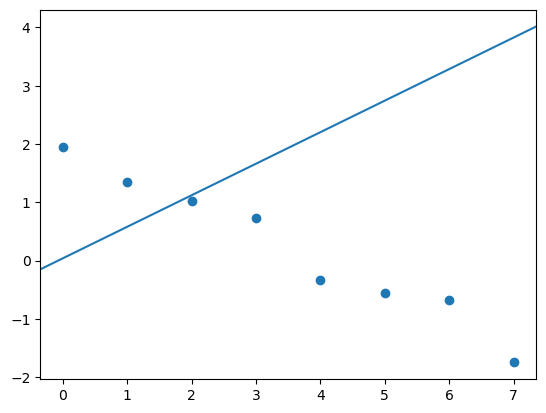

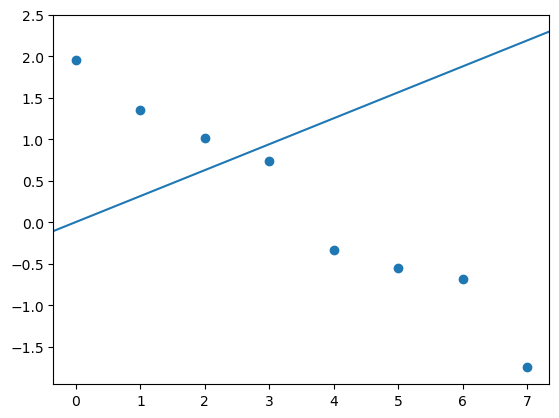

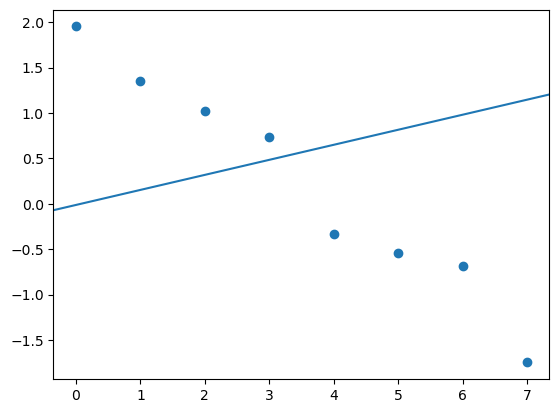

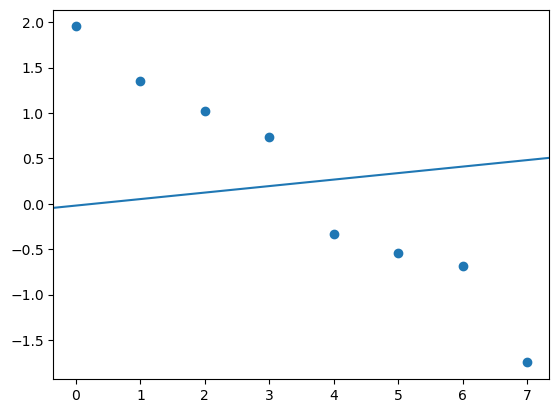

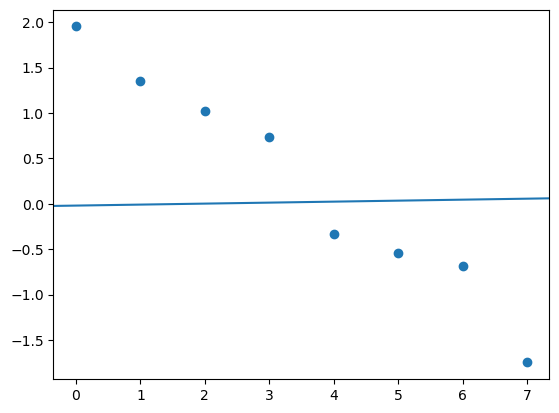

...

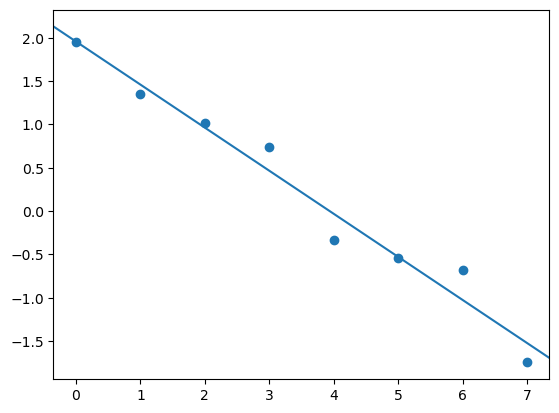

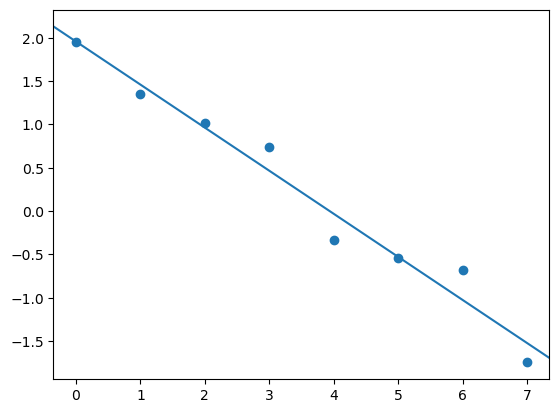

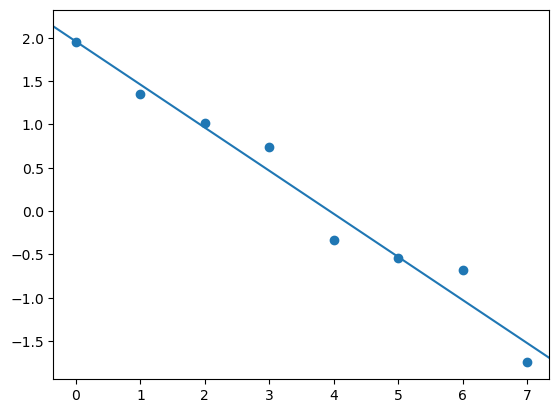

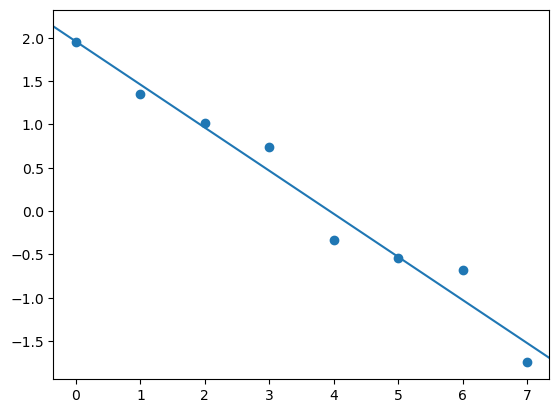

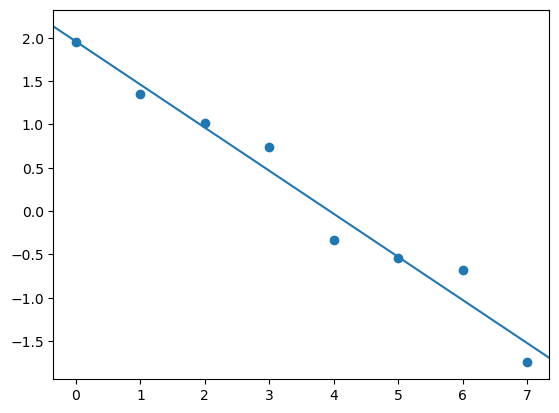

In [20]:
epochs = 1000

for i in range(0, epochs):
    y_hat = regression(x, m, b)
    C = mse(regression(x, m, b), y)
    print(f"{m}     {b}")
    C.backward()
    optimizer = torch.optim.SGD([m, b], lr = 0.01)
    optimizer.step()
    regression_plot(x, y, m.detach().numpy(), b.detach().numpy())
    optimizer.zero_grad()
